In [ ]:
import pandas as pd
import numpy as np
import geopandas as gpd
import glob
import matplotlib.pyplot as plt
import seaborn as sns
import itertools as it

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


In [2]:
cd

/Users/tk18583



# Load all the EPC files clean and save as csvs

# needs pandas and geopandas

## Needs UPRN data
## uprn = pd.read_csv('./../Data/Ordinance_Survey/osopenuprn_202302.csv')
## uprn['UPRN'] = uprn['UPRN'].astype('float64')
import glob
import pandas as pd
import numpy as np 

def load_clean_epc(path_to_epc, path_save_cleaned, columns_keep, UPRN_data):
    #list_paths = glob.glob("../Data/Energy_Performance_Certificate/all-domestic-certificates/*")
    import glob
    import pandas as pd

    list_paths = glob.glob(path_to_epc)
    
    for i in range(len(list_paths)):
        path = list_paths[i] + '/certificates.csv'
        name = list_paths[i][-20:]
        epc = pd.read_csv(path, usecols=columns_keep) # columns = ['TOTAL_FLOOR_AREA','UPRN','LODGEMENT_DATE']
        # clean the uprn and add
        epc['UPRN'] = epc['UPRN'].astype('float64')
        epc2 = epc.merge(UPRN_data, on = 'UPRN',how = 'left')
        # clean duplicates
        epc2['LODGEMENT_DATE'] = pd.to_datetime(epc2['LODGEMENT_DATE'], format='%Y-%m-%d')
        epc2 = epc2.sort_values(by="LODGEMENT_DATE").drop_duplicates(subset=["UPRN"], keep="last")
        epc2 = epc2.loc[epc2.groupby('UPRN').LODGEMENT_DATE.idxmax()]
        # save to new folder
        epc2.to_csv(str(path_save_cleaned +  name + '.csv')) # path_save_cleaned = './../Data/Energy_Performance_Certificate/cerificates_processed/'
    
    return('done')

def load_compile_epc(path_to_cleaned):

    list_paths2 = glob.glob(path_to_cleaned) #path_to_cleaned = "./../Data/Energy_Performance_Certificate/cerificates_processed/*.csv"

    data = pd.DataFrame()
    for i in range(len(glob.glob(path_to_cleaned))):
        x = pd.read_csv(list_paths2[i])
        data = pd.concat([data,x])

    data = gpd.GeoDataFrame(data, geometry = gpd.points_from_xy(data.LONGITUDE,data.LATITUDE), crs = "EPSG:4326")

    return(data)



def extract_data_from_epc(path_to_certificates, columns, uprn_data_path, save_to_folder):
    # load paths
    uprn = pd.read_csv(uprn_data_path)
    list_paths = glob.glob(path_to_certificates)
    original_length = []
    cleaned_length = []
    name_la = []

    # foor loop to extract all the data
    for i in range(len(list_paths)):
        path = list_paths[i] + '/certificates.csv'
        #  define names
        name = list_paths[i][-20:]
        # 
        epc = pd.read_csv(path, usecols=columns)
        # write length
        original_length.append(len(epc))
        name_la.append(len(name))
        # correct the UPRN
        epc['UPRN'] = epc['UPRN'].astype('float64')
        # merge the data
        epc2 = epc.merge(uprn, left_on = ['UPRN','LOCAL_AUTHORITY'] , right_on = ['UPRN','LAD21CD'],how = 'left')
        # drop the duplicates
        epc2['LODGEMENT_DATE'] = pd.to_datetime(epc2['LODGEMENT_DATE'], format='%Y-%m-%d')
        epc2 = epc2.sort_values(by="LODGEMENT_DATE").drop_duplicates(subset=["UPRN"], keep="last")
        epc2 = epc2.loc[epc2.groupby('UPRN').LODGEMENT_DATE.idxmax()]
        # measure length
        cleaned_length.append(len(epc2))
        # write cleaned data
        epc2.to_csv(str(save_to_folder + name + '.csv'))
    
    pd.DataFrame(data = {'original': original_length, 'cleaned':cleaned_length, 'name':name_la}).to_csv(str(save_to_folder + 'lengths_assesment.csv'))
    


def load_all_cleaned_certificates(list_of_paths):
    list_of_paths = glob.glob(list_of_paths)
    data = pd.DataFrame()
    for i in range(len(list_of_paths)):
        x = pd.read_csv(list_of_paths[i])
        data = pd.concat([data,x])
    return(data) 

In [4]:
list_paths = glob.glob('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/all-domestic-certificates/*')

uprn = pd.read_csv('./../../Volumes/Extreme_SSD/WORK/MAV/UPRN/osopenuprn_202409.csv')


for i in range(len(list_paths)):
    path = list_paths[i] + '/certificates.csv'
    name = list_paths[i][-20:]
    epc = pd.read_csv(path, usecols=['LODGEMENT_DATE','UPRN','TOTAL_FLOOR_AREA',
                                     'CONSTRUCTION_AGE_BAND','TENURE',
                                     'ENERGY_CONSUMPTION_CURRENT','ENERGY_CONSUMPTION_POTENTIAL'])
    epc2 = epc.merge(uprn, on = 'UPRN',how = 'left')
    epc2['LODGEMENT_DATE'] = pd.to_datetime(epc2['LODGEMENT_DATE'], format='%Y-%m-%d')
    epc2 = epc2.sort_values(by="LODGEMENT_DATE").drop_duplicates(subset=["UPRN"], keep="last")
    epc2 = epc2.loc[epc2.groupby('UPRN').LODGEMENT_DATE.idxmax()]
    epc2.to_csv(str('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/cleaned_floor_area/' +  name + '.csv'), index=False)

In [98]:
fl = load_compile_epc('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/cleaned_floor_area/*')
fl.head()

,LODGEMENT_DATE,ENERGY_CONSUMPTION_CURRENT,ENERGY_CONSUMPTION_POTENTIAL,TOTAL_FLOOR_AREA,CONSTRUCTION_AGE_BAND,TENURE,UPRN,LATITUDE,LONGITUDE,PROPERTY_TYPE,BUILT_FORM
0,2023-05-05,147,60.0,193.0,England and Wales: before 1900,Owner-occupied,1.009311e+09,50.497252,-3.752589,NaN,NaN
1,2023-04-24,260,105.0,264.0,England and Wales: 1900-1929,Owner-occupied,1.009311e+09,50.374284,-3.989030,NaN,NaN
2,2011-11-26,191,169.0,201.5,England and Wales: 1996-2002,rental (private),1.009311e+09,50.386777,-3.666289,NaN,NaN
3,2020-05-29,188,77.0,450.0,England and Wales: before 1900,owner-occupied,1.009311e+09,50.404028,-4.019857,NaN,NaN
4,2019-06-18,128,122.0,78.0,England and Wales: 2007 onwards,owner-occupied,1.009311e+09,50.361612,-3.666855,NaN,NaN


In [12]:
def load_compile_epc(path_to_cleaned):

    list_paths = glob.glob(path_to_cleaned) #path_to_cleaned = "./../Data/Energy_Performance_Certificate/cerificates_processed/*.csv"

    data = pd.DataFrame()
    for i in range(len(glob.glob(path_to_cleaned))):
        x = pd.read_csv(list_paths[i])
        data = pd.concat([data,x])

    #data = gpd.GeoDataFrame(data, geometry = gpd.points_from_xy(data.LONGITUDE,data.LATITUDE), crs = "EPSG:4326")

    return(data)

def winsor(variable):
    upper_percentile = np.percentile(variable, 99)
    lower_percentile = np.percentile(variable, 1)
    new_var = np.where(variable > upper_percentile, upper_percentile, variable)
    new_var = np.where(new_var < lower_percentile, lower_percentile, new_var)
    return(new_var)

def essen_clean(data):
    # eliminate rows before 01/05/2013
    data['LODGEMENT_DATE'] = pd.to_datetime(data['LODGEMENT_DATE'],format = '%Y-%m-%d')
    data = data[data['LODGEMENT_DATE'] >= '2013-05-01 00:00:00']
    # eliminate not geolocated rows
    data = data[~data['LSOA21CD'].isna()]

    return(data)



In [9]:
lookup = pd.read_csv('./../../Volumes/Extreme_SSD/WORK/MAV/UPRN/uprn_lsoa_lookup.csv').drop(['Unnamed: 0'],axis = 1)

In [99]:
fl = fl.merge(lookup, how = 'left', on = 'UPRN')
fl.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18515781 entries, 0 to 18515780
Data columns (total 12 columns):
 #   Column                        Dtype  
---  ------                        -----  
 0   LODGEMENT_DATE                object 
 1   ENERGY_CONSUMPTION_CURRENT    int64  
 2   ENERGY_CONSUMPTION_POTENTIAL  float64
 3   TOTAL_FLOOR_AREA              float64
 4   CONSTRUCTION_AGE_BAND         object 
 5   TENURE                        object 
 6   UPRN                          float64
 7   LATITUDE                      float64
 8   LONGITUDE                     float64
 9   PROPERTY_TYPE                 object 
 10  BUILT_FORM                    object 
 11  LSOA21CD                      object 
dtypes: float64(5), int64(1), object(6)
memory usage: 1.7+ GB


In [100]:
fl = essen_clean(fl)

In [101]:
fl['ENERGY_CONSUMPTION_CURRENT'] = winsor(fl['ENERGY_CONSUMPTION_CURRENT'])

In [102]:
age_lookup = pd.read_csv('./../../Volumes/Extreme_SSD/WORK/EPC/age_lookup.csv')
age_dict = age_lookup.set_index('CONSTRUCTION_AGE_BAND')['Category2'].to_dict()
fl['CONSTRUCTION_AGE_BAND'] = fl['CONSTRUCTION_AGE_BAND'].map(age_dict)

In [103]:
dict_ten = {'Owner-occupied':'Owner-occupied', 
'rental (private)':'Rented (private)', 
'owner-occupied':'Owner-occupied',
'Rented (private)':'Rented (private)', 
'unknown': np.nan, 
'Rented (social)':'Rented (social)',
'rental (social)':'Rented (social)',
'Not defined - use in the case of a new dwelling for which the intended tenure in not known. It is not to be used for an existing dwelling':np.nan,
'NO DATA!': np.nan}

fl['TENURE'] = fl['TENURE'].map(dict_ten)

In [67]:
fl.head()

,LODGEMENT_DATE,ENERGY_CONSUMPTION_CURRENT,ENERGY_CONSUMPTION_POTENTIAL,TOTAL_FLOOR_AREA,CONSTRUCTION_AGE_BAND,TENURE,UPRN,LATITUDE,LONGITUDE,PROPERTY_TYPE,BUILT_FORM,LSOA21CD
0,2023-05-05,147.0,60.0,193.0,before_1929,Owner-occupied,1.009311e+09,50.497252,-3.752589,NaN,NaN,E01020157
1,2023-04-24,260.0,105.0,264.0,before_1929,Owner-occupied,1.009311e+09,50.374284,-3.989030,NaN,NaN,E01020149
3,2020-05-29,188.0,77.0,450.0,before_1929,Owner-occupied,1.009311e+09,50.404028,-4.019857,NaN,NaN,E01020149
4,2019-06-18,128.0,122.0,78.0,2003_onwards,Owner-occupied,1.009311e+09,50.361612,-3.666855,NaN,NaN,E01020188
5,2024-07-08,142.0,118.0,336.0,2003_onwards,Owner-occupied,1.009311e+09,50.356038,-3.561769,NaN,NaN,E01020153


In [18]:
# library & dataset
import seaborn as sns
import matplotlib.pyplot as plt
plt.rcParams["figure.dpi"] = 300
df = sns.load_dataset('iris')
 
# Use the 'hue' argument to provide a factor variable
sns.scatterplot(
   x="TOTAL_FLOOR_AREA",
   y="ENERGY_CONSUMPTION_CURRENT",
   data=fl,
   hue='CONSTRUCTION_AGE_BAND',
)

plt.show()

/opt/anaconda3/envs/epc/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


KeyboardInterrupt: 

<Axes: >

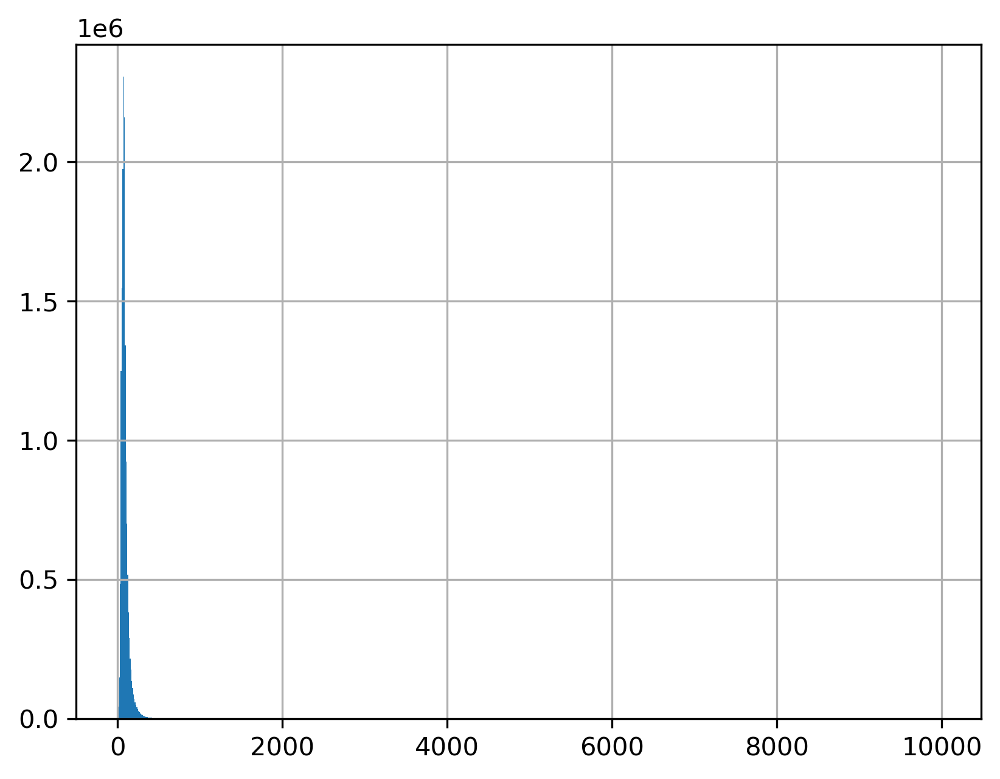

In [19]:
fl['TOTAL_FLOOR_AREA'].hist(bins = 1000)

In [68]:
# Calculate the percentage of properties with a floor area greater than 1000 m2
str(round(len(fl[fl['TOTAL_FLOOR_AREA']>1000])/len(fl)*100,2)) + '%'


'0.01%'

In [69]:
# Calculate the percentage of properties with a floor area less than 1000 m2
str(round(len(fl[fl['TOTAL_FLOOR_AREA']<1000])/len(fl)*100,2)) + '%'


'99.99%'

In [104]:
# clean up
fl['BUILT_FORM'].unique()
fl['BUILT_FORM'] = np.where(fl['BUILT_FORM'] == 'NO DATA!', np.nan, fl['BUILT_FORM'])
fl['BUILT_FORM'] = np.where(fl['BUILT_FORM'].isin(['Mid-Terrace',  'End-Terrace', 'Enclosed End-Terrace','Enclosed Mid-Terrace']), 'Terrace', fl['BUILT_FORM'])


In [105]:
# merge into one field
fl['PROP_TYPE_BUILD'] = np.where(fl['PROPERTY_TYPE'] == 'House', fl['PROPERTY_TYPE'] + '-' + fl['BUILT_FORM'] , fl['PROPERTY_TYPE'])

In [106]:
fl['PROP_TYPE_BUILD'].unique()

array([nan, 'House-Terrace', 'House-Semi-Detached', 'House-Detached',
       'Flat', 'Maisonette', 'Bungalow', 'Park home'], dtype=object)

In [107]:
# create dummy for sqm/sqfeet 1 = sqm, 0= sqfeet
fl['sqm'] = 0
fl['sqm'] = np.where((fl['PROPERTY_TYPE'] == 'Flat')&(fl['TOTAL_FLOOR_AREA']<200),1,0)
fl['sqm'] = np.where((fl['PROPERTY_TYPE'] == 'Park home')&(fl['TOTAL_FLOOR_AREA']<150),1,fl['sqm'])
fl['sqm'] = np.where((fl['PROPERTY_TYPE'] == 'Bungalow')&(fl['TOTAL_FLOOR_AREA']<300),1,fl['sqm'])
fl['sqm'] = np.where((fl['PROPERTY_TYPE'] == 'Maisonette')&(fl['TOTAL_FLOOR_AREA']<250),1,fl['sqm'])
fl['sqm'] = np.where((fl['PROPERTY_TYPE'] == 'House')&(fl['TOTAL_FLOOR_AREA']<500),1,fl['sqm'])

In [ ]:
fl['sqm'].value_counts(normalize = True)

sqm
1    0.829904
0    0.170096
Name: proportion, dtype: float64

In [108]:
fl['PROP_TYPE_BUILD'].unique()

array([nan, 'House-Terrace', 'House-Semi-Detached', 'House-Detached',
       'Flat', 'Maisonette', 'Bungalow', 'Park home'], dtype=object)

In [109]:
# Define your desired order
category1 = ['before_1929', '1930-1949', '1950-1975','1976-2002','2003_onwards']
category2 = ['Flat', 'Maisonette',  'Park home','Bungalow', 'House-Terrace', 'House-Semi-Detached', 'House-Detached']
# Convert 'Category' to a categorical type with order
fl['CONSTRUCTION_AGE_BAND'] = pd.Categorical(fl['CONSTRUCTION_AGE_BAND'], categories=category1, ordered=True)
fl['PROP_TYPE_BUILD'] = pd.Categorical(fl['PROP_TYPE_BUILD'], categories=category2, ordered=True)


/opt/anaconda3/envs/epc/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


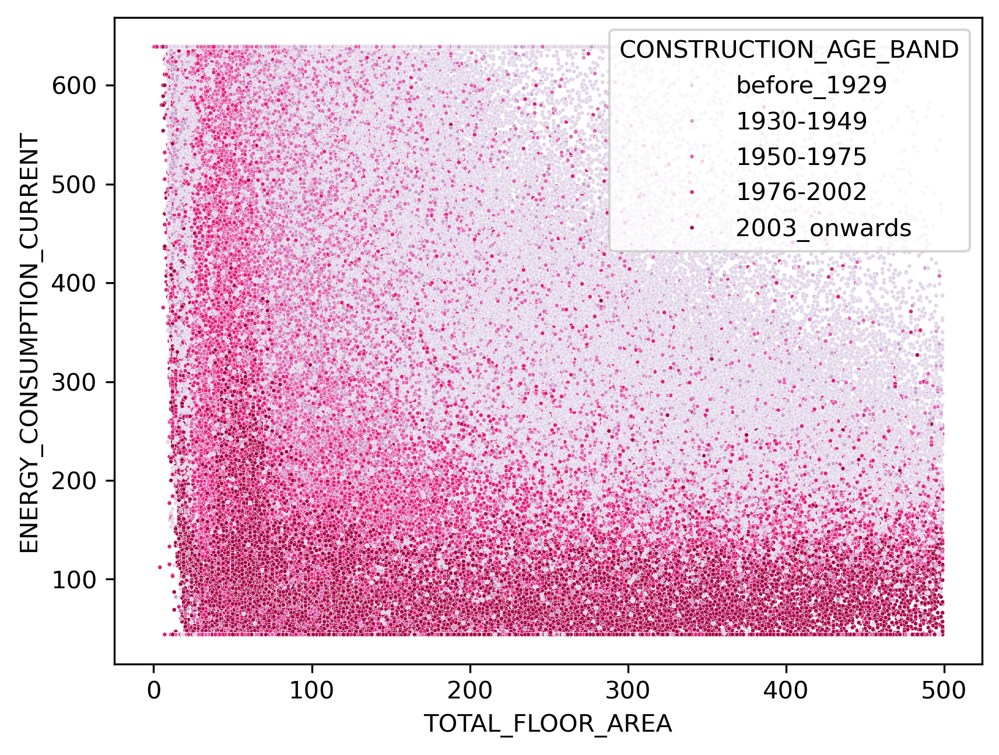

In [82]:
# Use the 'hue' argument to provide a factor variable
sns.scatterplot(
   x="TOTAL_FLOOR_AREA",
   y="ENERGY_CONSUMPTION_CURRENT",
   data=fl[fl['sqm'] == 1],
   hue='CONSTRUCTION_AGE_BAND',
   s=3,
   palette = 'PuRd'
)


plt.show()

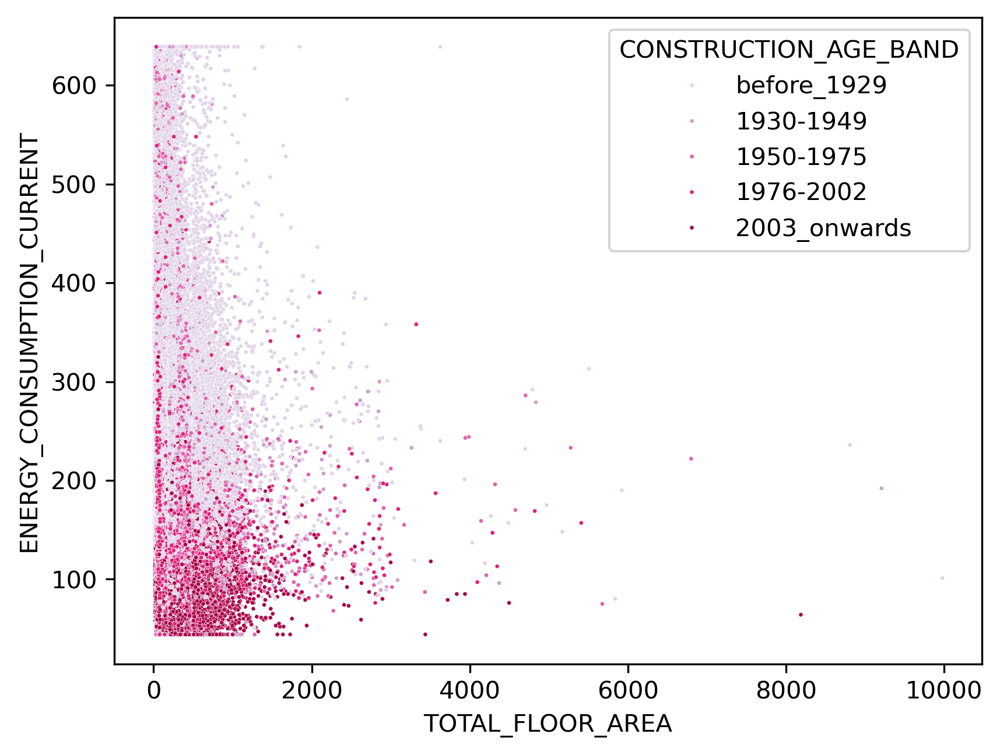

In [80]:
# Use the 'hue' argument to provide a factor variable
sns.scatterplot(
   x="TOTAL_FLOOR_AREA",
   y="ENERGY_CONSUMPTION_CURRENT",
   data=fl[fl['sqm'] == 0],
   hue='CONSTRUCTION_AGE_BAND',
   s=3,
   palette = 'PuRd'
)


plt.show()

In [84]:
flatfeet = fl[(fl['sqm'] == 0)&(fl['PROP_TYPE_BUILD'] == 'Flat')]

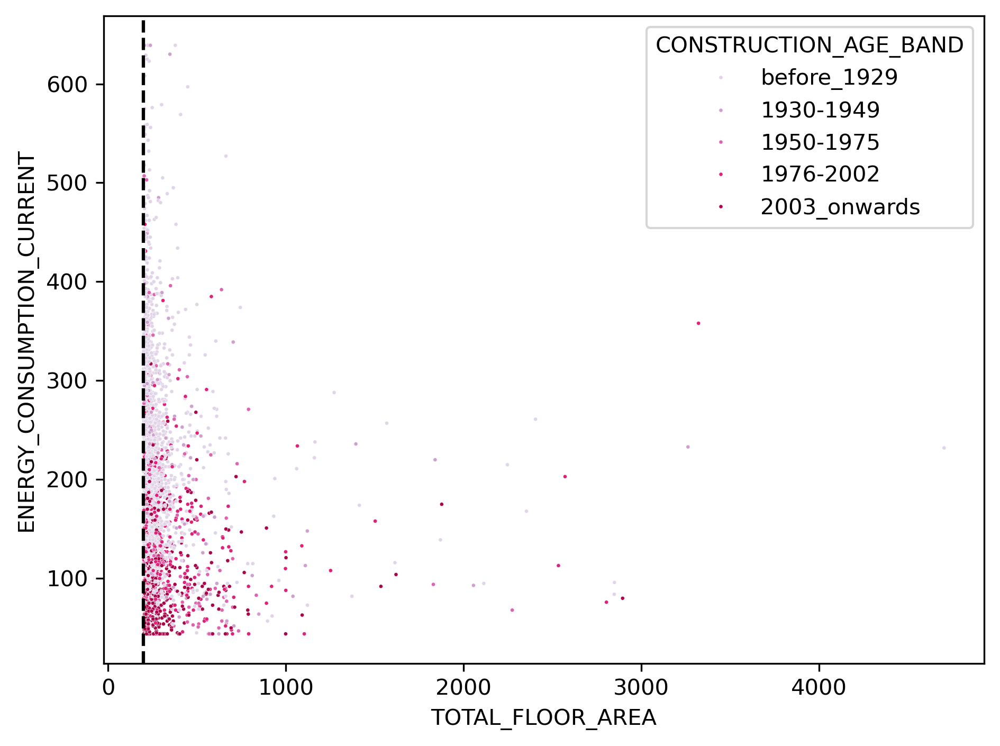

In [87]:
sns.scatterplot(
    x="TOTAL_FLOOR_AREA",
    y="ENERGY_CONSUMPTION_CURRENT",
    data=flatfeet,
    hue='CONSTRUCTION_AGE_BAND',
    s=3,
    palette='PuRd'
)

plt.axvline(x=200, color='black', linestyle='--', linewidth=1.5)  # vertical dashed line

plt.tight_layout()
plt.show()

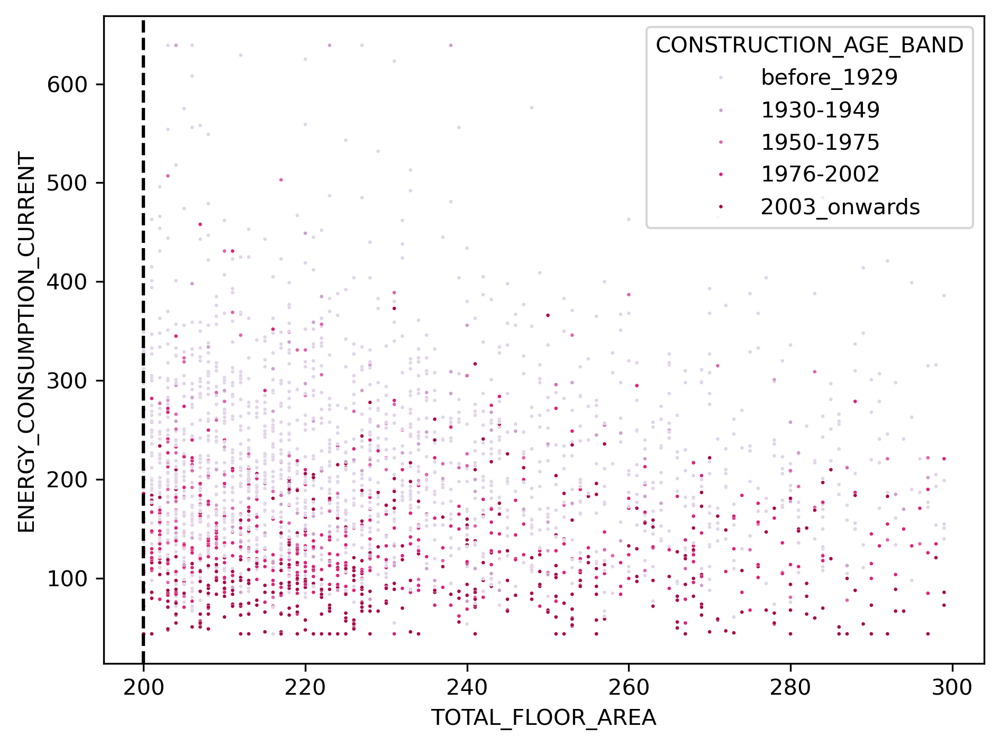

In [90]:
sns.scatterplot(
    x="TOTAL_FLOOR_AREA",
    y="ENERGY_CONSUMPTION_CURRENT",
    data=flatfeet[flatfeet['TOTAL_FLOOR_AREA']<300],
    hue='CONSTRUCTION_AGE_BAND',
    s=3,
    palette='PuRd'
)

plt.axvline(x=200, color='black', linestyle='--', linewidth=1.5)  # vertical dashed line

plt.tight_layout()
plt.show()

In [91]:
flatfeet[flatfeet['TOTAL_FLOOR_AREA']<300]

,LODGEMENT_DATE,ENERGY_CONSUMPTION_CURRENT,ENERGY_CONSUMPTION_POTENTIAL,TOTAL_FLOOR_AREA,CONSTRUCTION_AGE_BAND,TENURE,UPRN,LATITUDE,LONGITUDE,PROPERTY_TYPE,BUILT_FORM,LSOA21CD,PROP_TYPE_BUILD,sqm
3149513,2014-03-24,227.0,155.0,212.0,before_1929,Owner-occupied,1.775023e+09,50.780152,-1.079040,Flat,Detached,E01017073,Flat,0
3156766,2014-03-15,120.0,109.0,217.0,1930-1949,Owner-occupied,1.775036e+09,50.847110,-1.038040,Flat,Detached,E01032604,Flat,0
3160710,2018-05-16,204.0,167.0,204.0,before_1929,Owner-occupied,1.775043e+09,50.788033,-1.094420,Flat,Semi-Detached,E01017127,Flat,0
3161562,2017-09-05,253.0,105.0,216.0,1950-1975,Owner-occupied,1.775044e+09,50.812154,-1.079703,Flat,Terrace,E01017102,Flat,0
3167840,2019-10-07,157.0,111.0,250.0,1930-1949,Owner-occupied,1.775055e+09,50.786729,-1.084004,Flat,Semi-Detached,E01017122,Flat,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18400353,2017-12-05,134.0,121.0,225.0,1976-2002,Owner-occupied,2.000035e+11,51.507448,-0.102176,Flat,Terrace,E01003934,Flat,0
18480235,2023-09-08,170.0,145.0,221.0,2003_onwards,Rented (private),1.000126e+11,53.575912,-2.442664,Flat,Terrace,E01004871,Flat,0
18487287,2020-07-22,268.0,238.0,203.0,1976-2002,Owner-occupied,2.000026e+11,53.614569,-2.428451,Flat,Terrace,E01004808,Flat,0
18509144,2022-10-27,206.0,104.0,279.0,before_1929,Owner-occupied,1.480367e+08,51.734307,-0.037900,Flat,Terrace,E01023341,Flat,0


In [110]:
fl.info()

<class 'pandas.core.frame.DataFrame'>
Index: 15271163 entries, 0 to 18515780
Data columns (total 14 columns):
 #   Column                        Dtype         
---  ------                        -----         
 0   LODGEMENT_DATE                datetime64[ns]
 1   ENERGY_CONSUMPTION_CURRENT    float64       
 2   ENERGY_CONSUMPTION_POTENTIAL  float64       
 3   TOTAL_FLOOR_AREA              float64       
 4   CONSTRUCTION_AGE_BAND         category      
 5   TENURE                        object        
 6   UPRN                          float64       
 7   LATITUDE                      float64       
 8   LONGITUDE                     float64       
 9   PROPERTY_TYPE                 object        
 10  BUILT_FORM                    object        
 11  LSOA21CD                      object        
 12  PROP_TYPE_BUILD               category      
 13  sqm                           int64         
dtypes: category(2), datetime64[ns](1), float64(6), int64(1), object(4)
memory usage: 1.5+

fl = fl[fl['TOTAL_FLOOR_AREA']<1000]

/opt/anaconda3/envs/epc/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


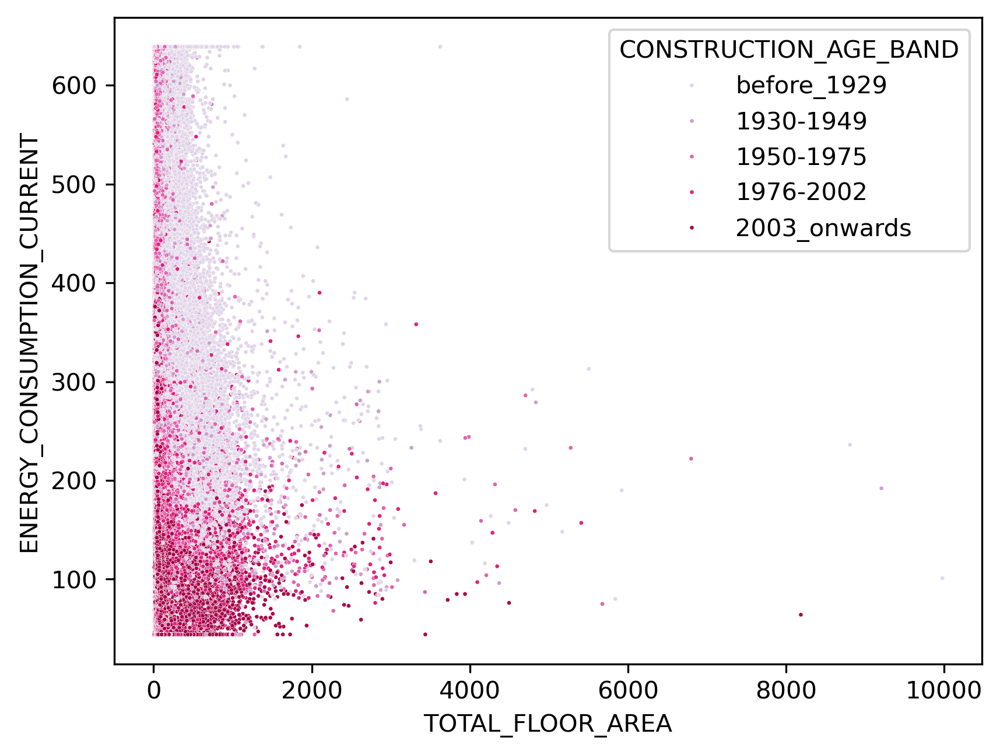

In [120]:
# Use the 'hue' argument to provide a factor variable
sns.scatterplot(
   x="TOTAL_FLOOR_AREA",
   y="ENERGY_CONSUMPTION_CURRENT",
   data=fl,
   hue='CONSTRUCTION_AGE_BAND',
   s=3,
   palette= 'PuRd'
)


plt.show()

In [ ]:
# Use the 'hue' argument to provide a factor variable
sns.scatterplot(
   x="TOTAL_FLOOR_AREA",
   y="ENERGY_CONSUMPTION_CURRENT",
   data=fl[fl],
   hue='CONSTRUCTION_AGE_BAND',
   s=3,
   palette= 'PuRd'
)


plt.show()

In [114]:
test2 = fl[fl['sqm'] == 1]
agg2 = round(test2.loc[:,['PROP_TYPE_BUILD','TOTAL_FLOOR_AREA']].groupby('PROP_TYPE_BUILD').aggregate({'TOTAL_FLOOR_AREA':['median','mean']}).reset_index(),2)
agg2.columns = [c[0] + "_" + c[1] for c in agg2.columns]

agg = round(fl.loc[:,['PROP_TYPE_BUILD','TOTAL_FLOOR_AREA']].groupby('PROP_TYPE_BUILD').aggregate({'TOTAL_FLOOR_AREA':['median','mean']}).reset_index(),2)
agg.columns = [c[0] + "_" + c[1] for c in agg.columns]

/var/folders/t5/57qdsp617xj8dd1by4td7fl40000gq/T/ipykernel_2134/2134834214.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  agg2 = round(test2.loc[:,['PROP_TYPE_BUILD','TOTAL_FLOOR_AREA']].groupby('PROP_TYPE_BUILD').aggregate({'TOTAL_FLOOR_AREA':['median','mean']}).reset_index(),2)
/var/folders/t5/57qdsp617xj8dd1by4td7fl40000gq/T/ipykernel_2134/2134834214.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  agg = round(fl.loc[:,['PROP_TYPE_BUILD','TOTAL_FLOOR_AREA']].groupby('PROP_TYPE_BUILD').aggregate({'TOTAL_FLOOR_AREA':['median','mean']}).reset_index(),2)


In [113]:
agg2

,PROP_TYPE_BUILD_,TOTAL_FLOOR_AREA_median,TOTAL_FLOOR_AREA_mean
0,Flat,55.0,57.05
1,Maisonette,69.0,72.61
2,Park home,57.0,55.60
3,Bungalow,71.0,80.66
4,House-Terrace,81.0,86.83
5,House-Semi-Detached,86.0,93.41
6,House-Detached,128.0,145.22


In [115]:
agg['sqf_measurements'] = 'with'
agg2['sqf_measurements'] = 'without'

tab = pd.concat([agg,agg2])
tab

,PROP_TYPE_BUILD_,TOTAL_FLOOR_AREA_median,TOTAL_FLOOR_AREA_mean,sqf_measurements
0,Flat,55.0,57.35,with
1,Maisonette,69.0,73.16,with
2,Park home,57.0,55.70,with
3,Bungalow,71.0,81.38,with
4,House-Terrace,81.0,87.04,with
5,House-Semi-Detached,86.0,93.64,with
6,House-Detached,128.0,148.77,with
0,Flat,55.0,57.05,without
1,Maisonette,69.0,72.61,without
2,Park home,57.0,55.60,without


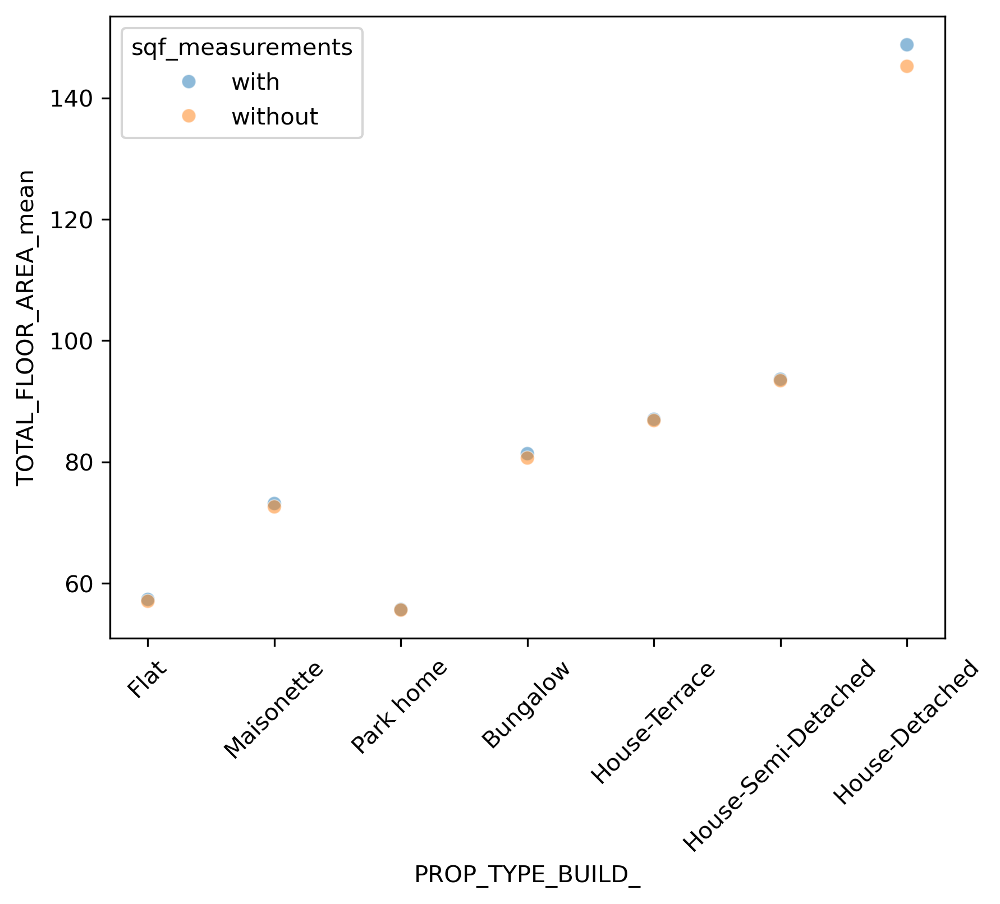

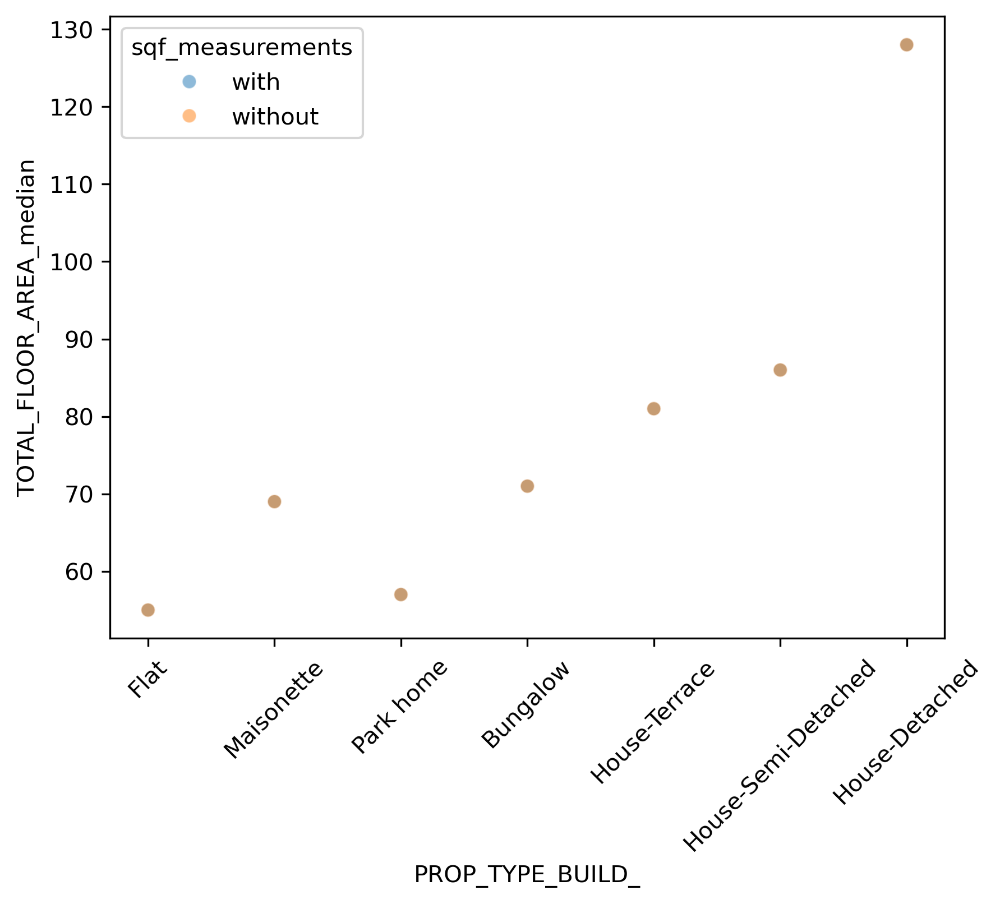

In [118]:
sns.scatterplot(data = tab, x = 'PROP_TYPE_BUILD_', y = 'TOTAL_FLOOR_AREA_mean', hue = 'sqf_measurements', alpha = 0.5)
plt.xticks(rotation=45)  
plt.show()
sns.scatterplot(data = tab, x = 'PROP_TYPE_BUILD_', y = 'TOTAL_FLOOR_AREA_median', hue = 'sqf_measurements', alpha = 0.5)
plt.xticks(rotation=45)  
plt.show()

In [121]:
fl2 = fl[fl['sqm'] == 1]

/opt/anaconda3/envs/epc/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


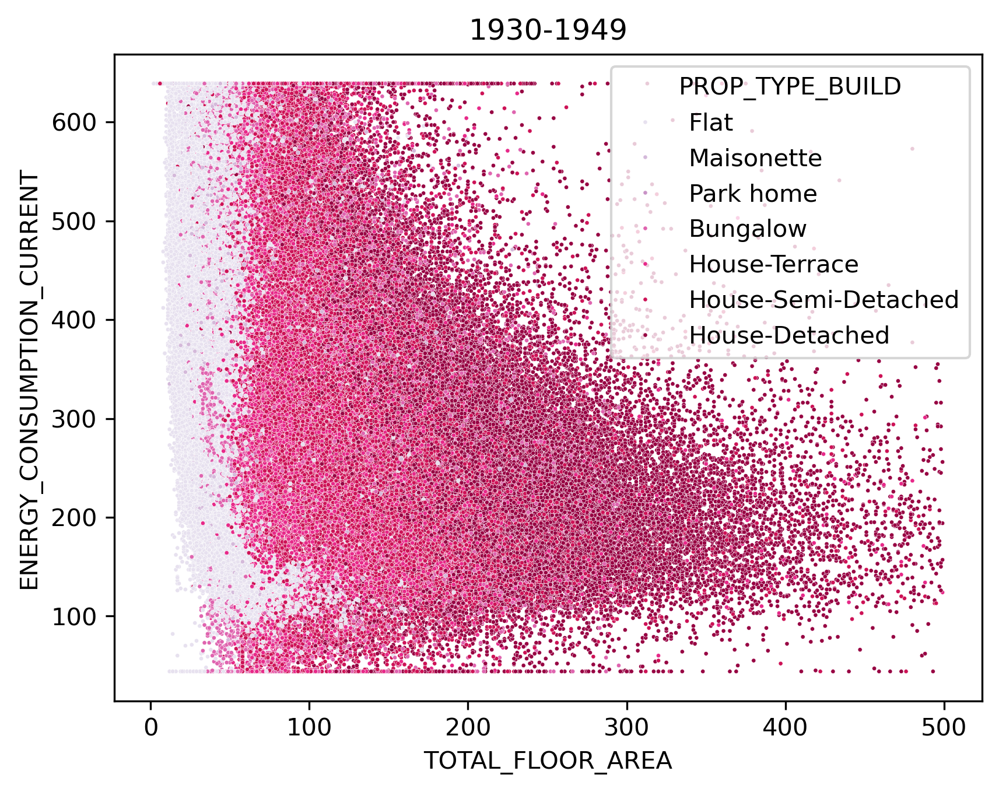

/opt/anaconda3/envs/epc/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


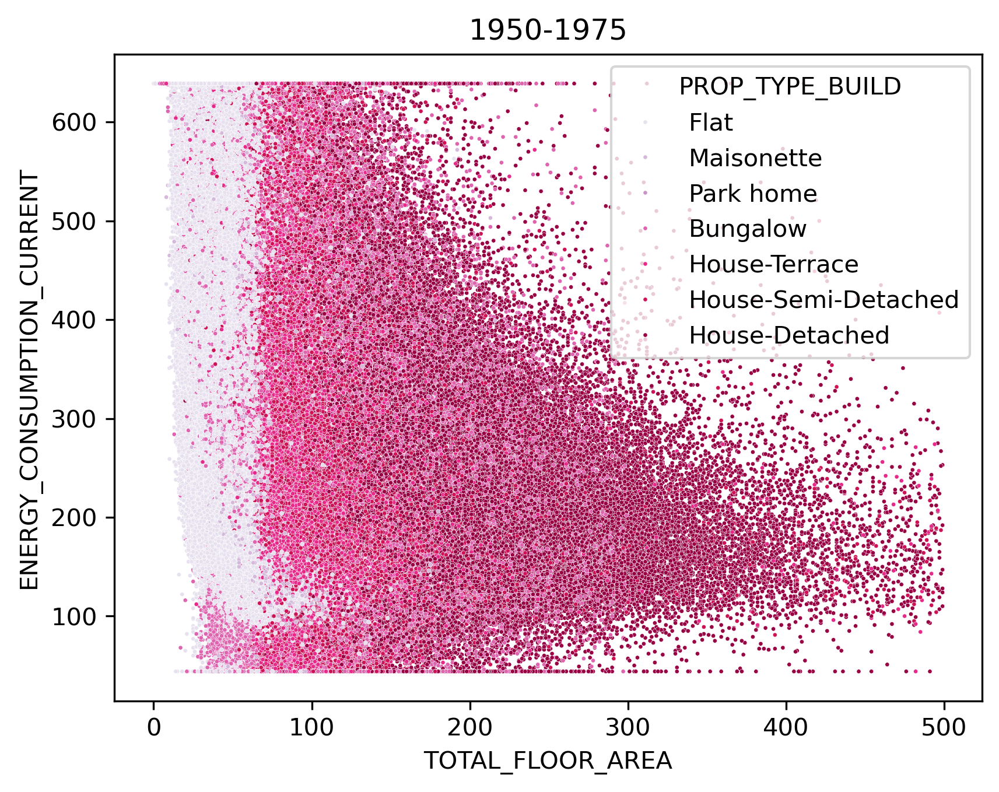

/opt/anaconda3/envs/epc/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


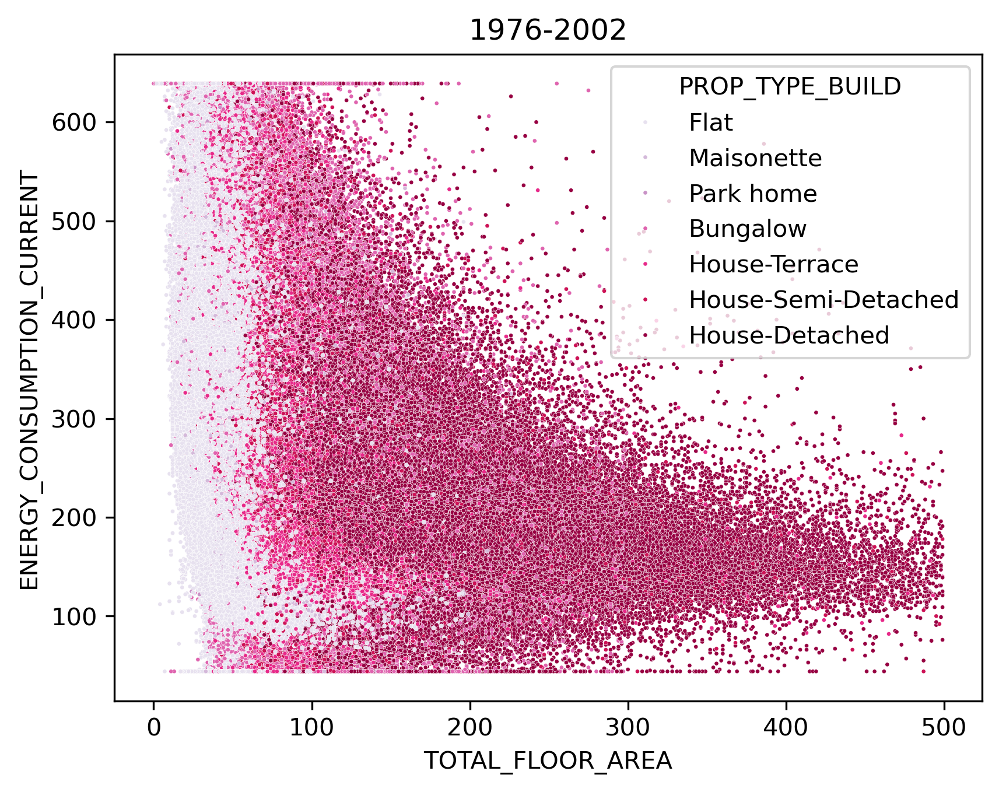

/opt/anaconda3/envs/epc/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


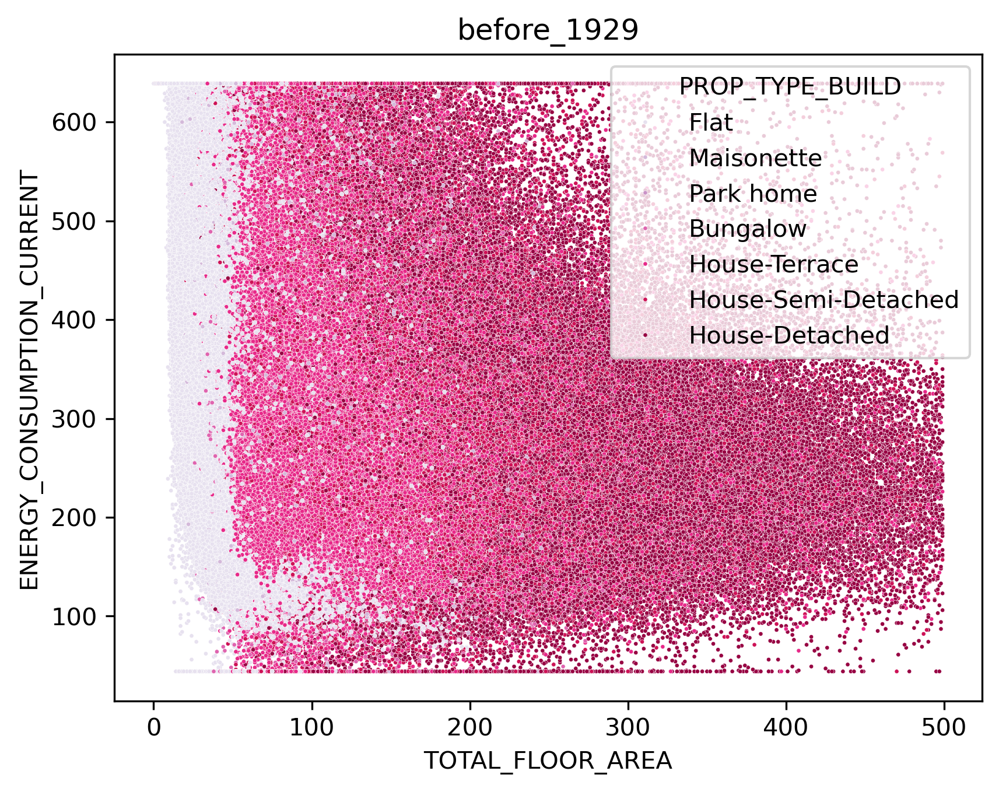

/opt/anaconda3/envs/epc/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


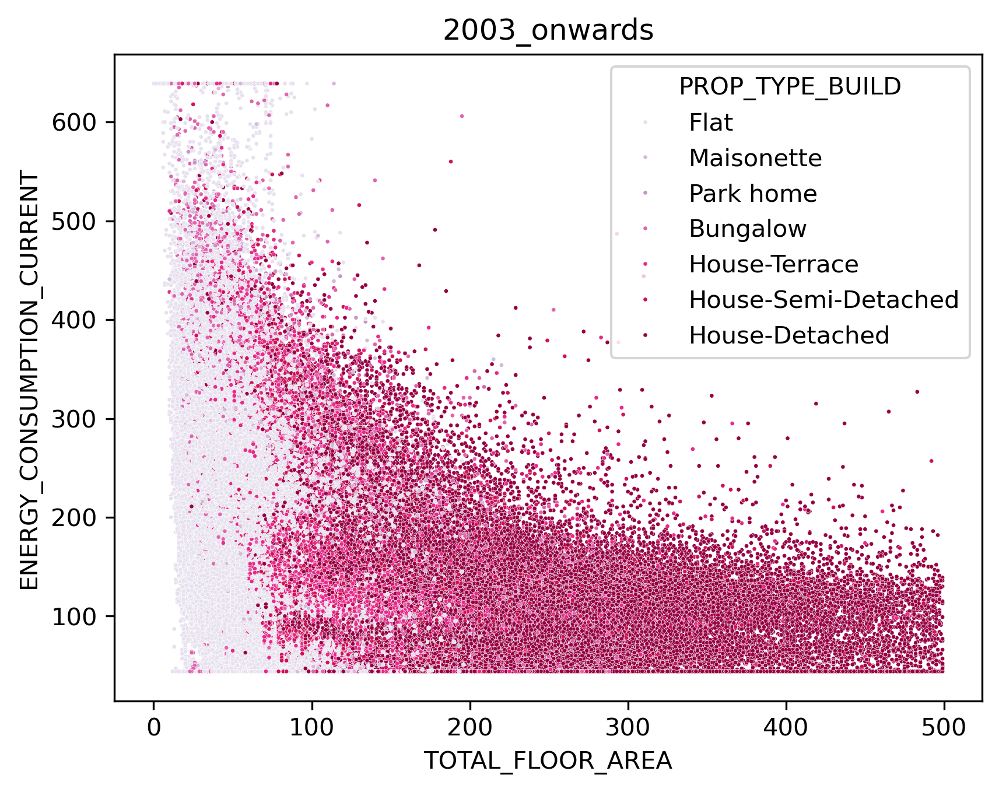

/var/folders/t5/57qdsp617xj8dd1by4td7fl40000gq/T/ipykernel_2134/3096903117.py:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(


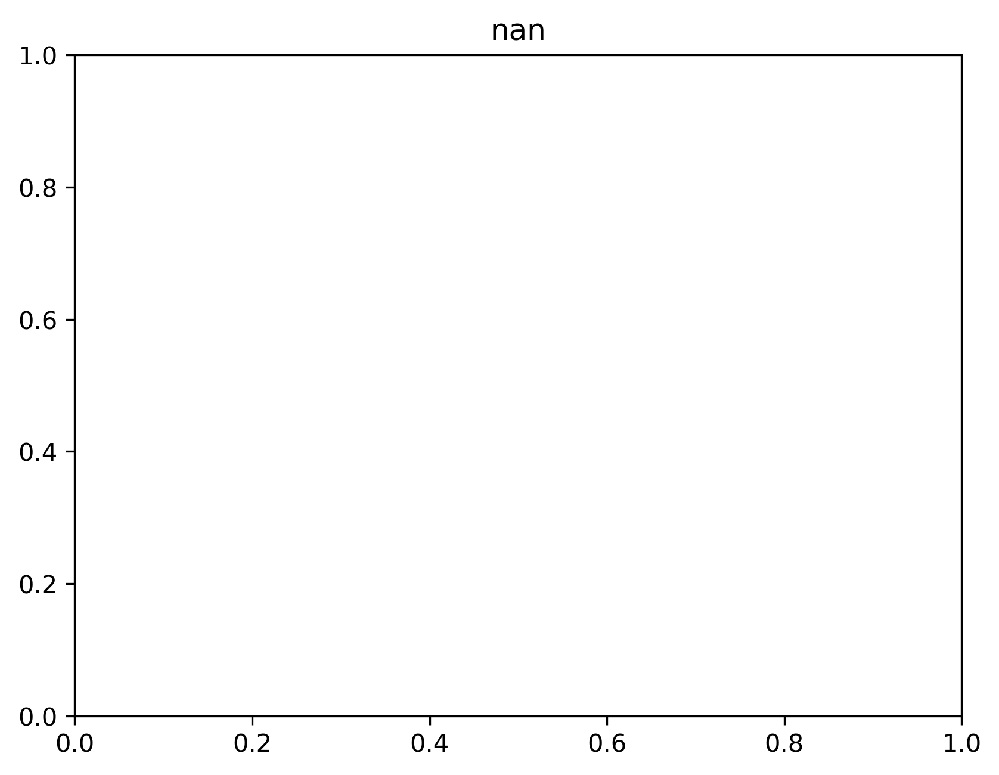

In [124]:
# Use the 'hue' argument to provide a factor variable
for i in fl2['CONSTRUCTION_AGE_BAND'].unique():
    sns.scatterplot(
    x="TOTAL_FLOOR_AREA",
    y="ENERGY_CONSUMPTION_CURRENT",
    data=fl2[fl2['CONSTRUCTION_AGE_BAND'] == i],
    hue='PROP_TYPE_BUILD',
    s=3,
    palette='PuRd'
    )
    plt.title(i)
    plt.show()

/opt/anaconda3/envs/epc/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


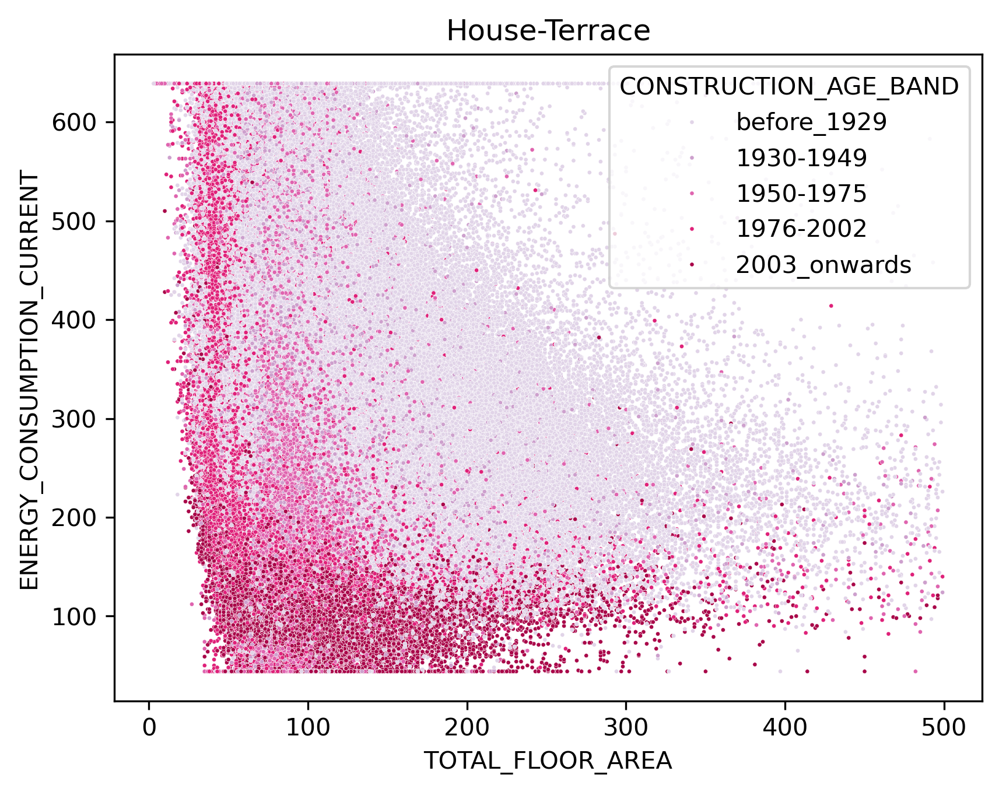

/opt/anaconda3/envs/epc/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


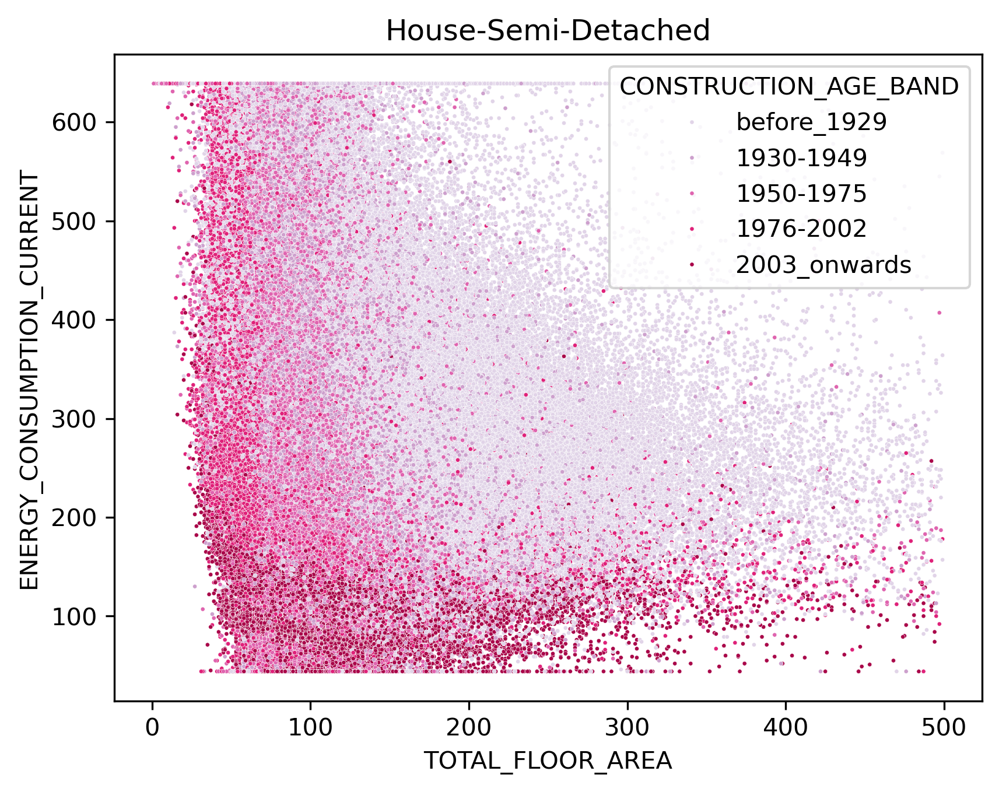

/opt/anaconda3/envs/epc/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


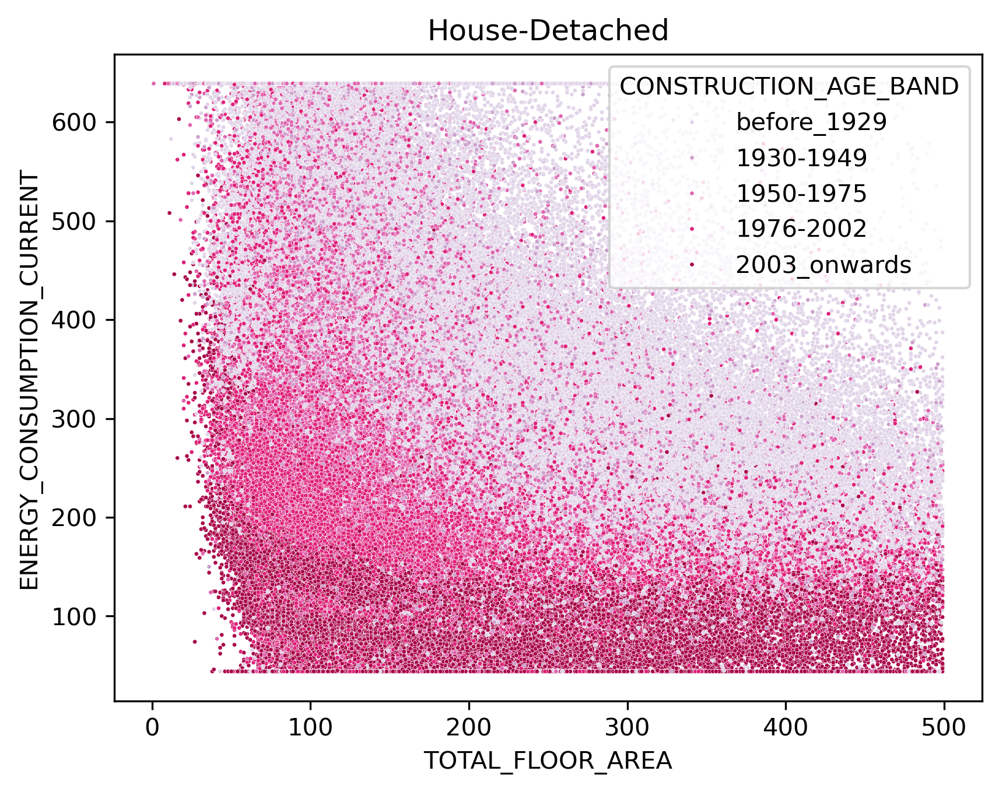

/opt/anaconda3/envs/epc/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


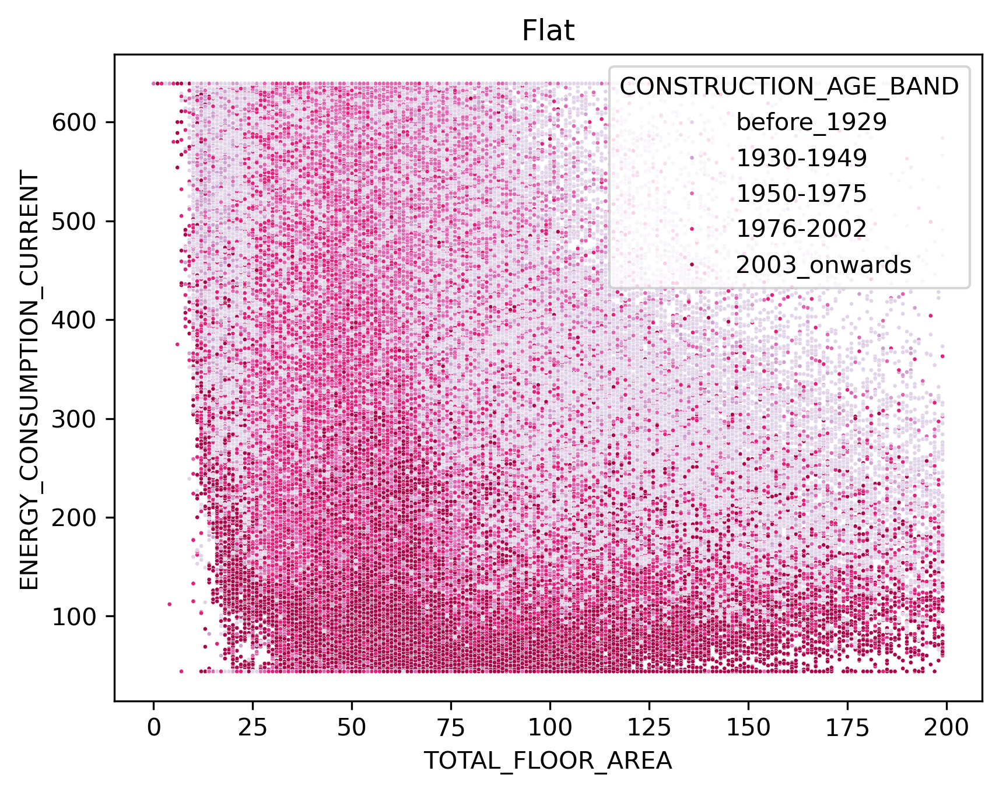

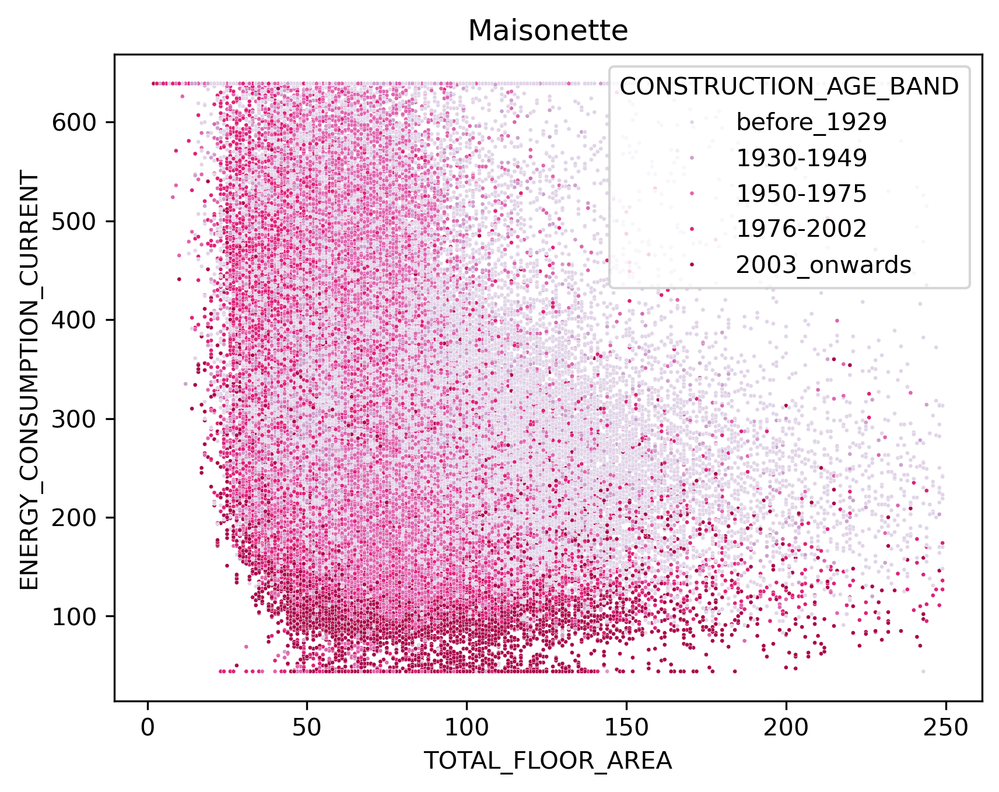

/opt/anaconda3/envs/epc/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


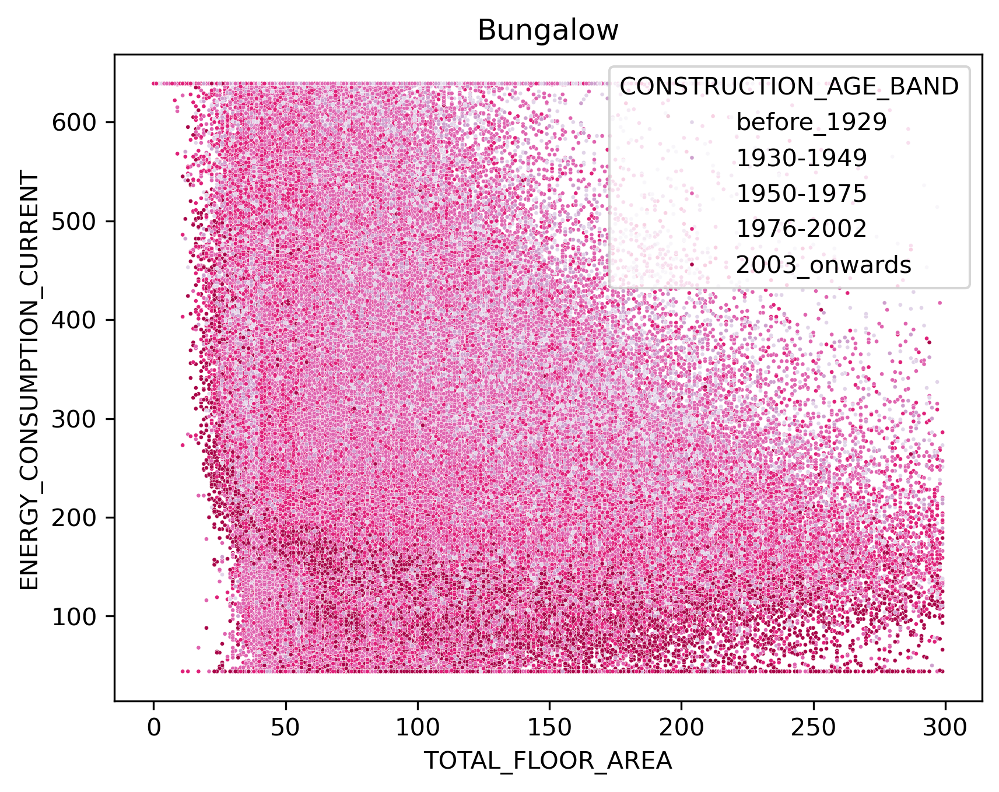

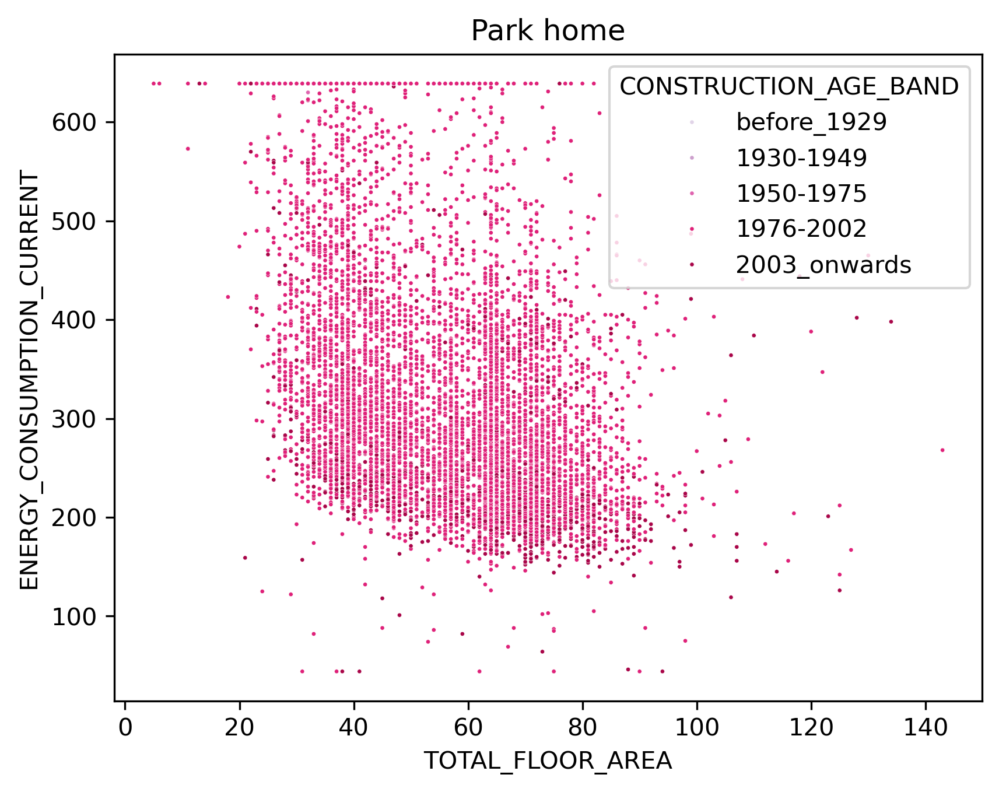

/var/folders/t5/57qdsp617xj8dd1by4td7fl40000gq/T/ipykernel_2134/582568357.py:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(


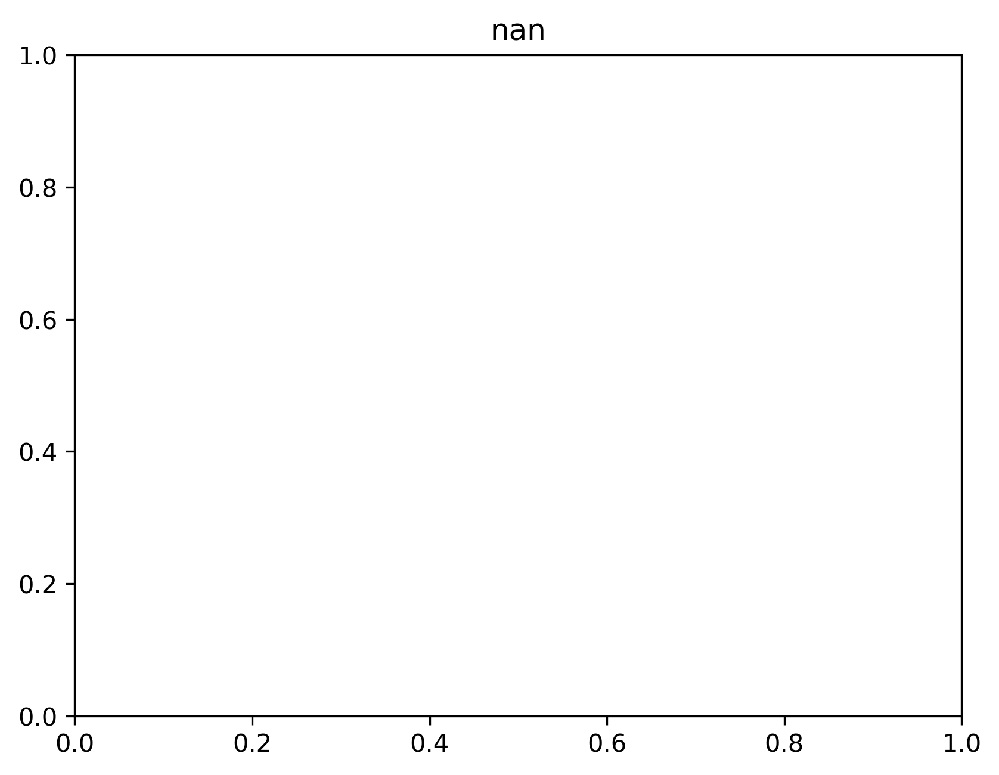

In [125]:
# Use the 'hue' argument to provide a factor variable
for i in fl2['PROP_TYPE_BUILD'].unique():
    sns.scatterplot(
    x="TOTAL_FLOOR_AREA",
    y="ENERGY_CONSUMPTION_CURRENT",
    data=fl2[fl2['PROP_TYPE_BUILD'] == i],
    hue='CONSTRUCTION_AGE_BAND',
    s=3,
    palette='PuRd'
    )
    plt.title(i)
    plt.show()

fl.info()

fl.info()

In [126]:
fl.info()

<class 'pandas.core.frame.DataFrame'>
Index: 15271163 entries, 0 to 18515780
Data columns (total 14 columns):
 #   Column                        Dtype         
---  ------                        -----         
 0   LODGEMENT_DATE                datetime64[ns]
 1   ENERGY_CONSUMPTION_CURRENT    float64       
 2   ENERGY_CONSUMPTION_POTENTIAL  float64       
 3   TOTAL_FLOOR_AREA              float64       
 4   CONSTRUCTION_AGE_BAND         category      
 5   TENURE                        object        
 6   UPRN                          float64       
 7   LATITUDE                      float64       
 8   LONGITUDE                     float64       
 9   PROPERTY_TYPE                 object        
 10  BUILT_FORM                    object        
 11  LSOA21CD                      object        
 12  PROP_TYPE_BUILD               category      
 13  sqm                           int64         
dtypes: category(2), datetime64[ns](1), float64(6), int64(1), object(4)
memory usage: 1.5+

In [130]:
fl2['COUNT'] = 1

/var/folders/t5/57qdsp617xj8dd1by4td7fl40000gq/T/ipykernel_2134/3692255581.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fl2['COUNT'] = 1


In [133]:
agg = round(fl2.groupby('LSOA21CD').aggregate({'TOTAL_FLOOR_AREA':['mean','median','count'], 
                            'ENERGY_CONSUMPTION_CURRENT':['mean','median']}
                            ).reset_index(),2)
agg.columns = [c[0] + "_" + c[1] for c in agg.columns]
agg= agg.rename(columns = {'LSOA21CD_':'LSOA21CD'})
agg.head()

,LSOA21CD,TOTAL_FLOOR_AREA_mean,TOTAL_FLOOR_AREA_median,TOTAL_FLOOR_AREA_count,ENERGY_CONSUMPTION_CURRENT_mean,ENERGY_CONSUMPTION_CURRENT_median
0,E01000005,27.40,27.0,5,250.40,244.0
1,E01000006,85.16,89.0,359,257.35,248.0
2,E01000007,64.25,59.0,1004,129.79,104.0
3,E01000008,68.28,74.0,277,180.43,171.0
4,E01000009,75.00,57.0,457,263.53,253.0


In [134]:
agg.to_csv('./../../Volumes/Extreme_SSD/WORK/EPC/english_EPC/agg_floor_space_test.csv', index = False)